Perform Exploratory Data Analysis 

# Import libraries

In [1]:
# Libraries neeeded to work on the data
import scipy.stats as stats
import os
import math
import pandas as pd
import numpy as np

from sklearn.preprocessing import OneHotEncoder, Normalizer, LabelEncoder
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

In [2]:
# MySQL libraries
import pymysql
from sqlalchemy import create_engine

import getpass
import matplotlib.pyplot as plt
import seaborn as sns

password = getpass.getpass()

········


# Import data

Importing data from MySQL credit_card_data database

In [5]:
connection_string = 'mysql+pymysql://root:' + password + '@localhost/credit_card_classification'
engine = create_engine(connection_string)
query = ''' 
        
        Select *
        from credit_card_data
        ;
        '''


In [6]:
pd.read_sql_table('credit_card_data', engine) 

,MyUnknownColumn,customer_number,offer_accepted,reward,mailer_type,income_level,bank_accounts_open,overdraft_protection,credit_rating,credit_cards_held,homes_owned,household_size,own_your_home,average_balance,q1_balance,q2_balance,q3_balance,q4_balance
0,0,1,No,Air Miles,Letter,High,1,No,High,2,1,4,No,1160.75,1669.0,877.0,1095.0,1002.0
1,1,2,No,Air Miles,Letter,Medium,1,No,Medium,2,2,5,Yes,147.25,39.0,106.0,78.0,366.0
2,2,3,No,Air Miles,Postcard,High,2,No,Medium,2,1,2,Yes,276.50,367.0,352.0,145.0,242.0
3,3,4,No,Air Miles,Letter,Medium,2,No,High,1,1,4,No,1219.00,1578.0,1760.0,1119.0,419.0
4,4,5,No,Air Miles,Letter,Medium,1,No,Medium,2,1,6,Yes,1211.00,2140.0,1357.0,982.0,365.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17971,17995,17996,No,Cash Back,Letter,High,1,No,Low,1,1,5,Yes,167.50,136.0,65.0,71.0,398.0
17972,17996,17997,No,Cash Back,Letter,High,1,No,Low,3,1,3,Yes,850.50,984.0,940.0,943.0,535.0
17973,17997,17998,No,Cash Back,Letter,High,1,No,Low,2,1,4,No,1087.25,918.0,767.0,1170.0,1494.0
17974,17998,17999,No,Cash Back,Letter,Medium,1,No,Medium,4,2,2,Yes,1022.25,626.0,983.0,865.0,1615.0


# Data exploring

In [7]:
pd.set_option('max_row', None) # to get all the column
data.dtypes

MyUnknownColumn           int64
customer_number           int64
offer_accepted           object
reward                   object
mailer_type              object
income_level             object
bank_accounts_open        int64
overdraft_protection     object
credit_rating            object
credit_cards_held         int64
homes_owned               int64
household_size            int64
own_your_home            object
average_balance         float64
q1_balance              float64
q2_balance              float64
q3_balance              float64
q4_balance              float64
dtype: object

In [8]:
pd.set_option('max_row', None)
data.columns

Index(['MyUnknownColumn', 'customer_number', 'offer_accepted', 'reward',
       'mailer_type', 'income_level', 'bank_accounts_open',
       'overdraft_protection', 'credit_rating', 'credit_cards_held',
       'homes_owned', 'household_size', 'own_your_home', 'average_balance',
       'q1_balance', 'q2_balance', 'q3_balance', 'q4_balance'],
      dtype='object')

In [9]:
data.isna().sum()

MyUnknownColumn         0
customer_number         0
offer_accepted          0
reward                  0
mailer_type             0
income_level            0
bank_accounts_open      0
overdraft_protection    0
credit_rating           0
credit_cards_held       0
homes_owned             0
household_size          0
own_your_home           0
average_balance         0
q1_balance              0
q2_balance              0
q3_balance              0
q4_balance              0
dtype: int64

In [10]:
for col in data.select_dtypes('object'):
    print(data[col].value_counts(), '\n')

No     16955
Yes     1021
Name: offer_accepted, dtype: int64 

Air Miles    6047
Cash Back    5995
Points       5934
Name: reward, dtype: int64 

Postcard    9134
Letter      8842
Name: mailer_type, dtype: int64 

Medium    9002
High      4519
Low       4455
Name: income_level, dtype: int64 

No     15300
Yes     2676
Name: overdraft_protection, dtype: int64 

High      6064
Medium    5964
Low       5948
Name: credit_rating, dtype: int64 

Yes    11636
No      6340
Name: own_your_home, dtype: int64 



# Data cleaning and wrangling

In [11]:
# New index 
data = data.set_index('customer_number')
data

,MyUnknownColumn,offer_accepted,reward,mailer_type,income_level,bank_accounts_open,overdraft_protection,credit_rating,credit_cards_held,homes_owned,household_size,own_your_home,average_balance,q1_balance,q2_balance,q3_balance,q4_balance
customer_number,,,,,,,,,,,,,,,,,
1,0,No,Air Miles,Letter,High,1,No,High,2,1,4,No,1160.75,1669.0,877.0,1095.0,1002.0
2,1,No,Air Miles,Letter,Medium,1,No,Medium,2,2,5,Yes,147.25,39.0,106.0,78.0,366.0
3,2,No,Air Miles,Postcard,High,2,No,Medium,2,1,2,Yes,276.50,367.0,352.0,145.0,242.0
4,3,No,Air Miles,Letter,Medium,2,No,High,1,1,4,No,1219.00,1578.0,1760.0,1119.0,419.0
5,4,No,Air Miles,Letter,Medium,1,No,Medium,2,1,6,Yes,1211.00,2140.0,1357.0,982.0,365.0
6,5,No,Air Miles,Letter,Medium,1,No,High,3,1,4,No,1114.75,1847.0,1365.0,750.0,497.0
7,6,No,Air Miles,Letter,Medium,1,No,Medium,2,1,3,No,283.75,468.0,188.0,347.0,132.0
8,7,No,Cash Back,Postcard,Low,1,No,Medium,4,1,4,Yes,278.50,132.0,391.0,285.0,306.0
9,8,No,Air Miles,Postcard,Medium,1,No,Low,2,1,4,Yes,1005.00,894.0,891.0,882.0,1353.0


In [ ]:
# Distribution

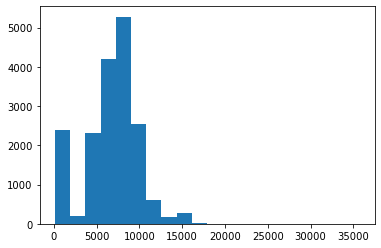

In [25]:
plt.hist(data['average_balance'].interpolate(method='polynomial', order=2), bins=20) 
plt.show()

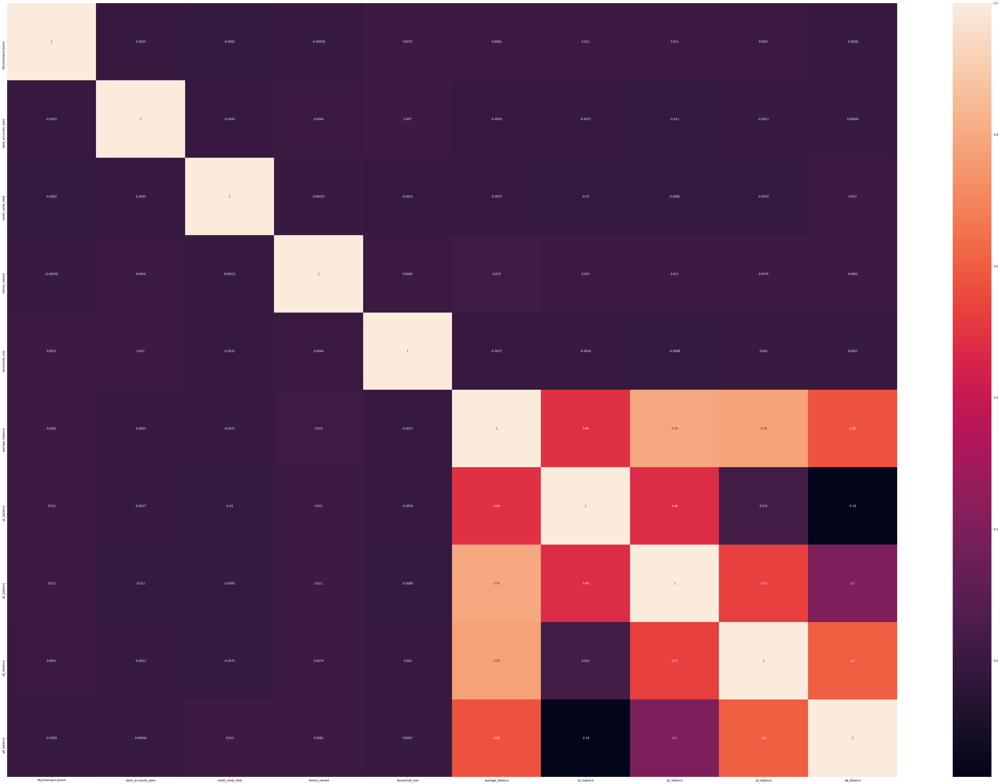

In [26]:
corr_matrix=data.corr(method='pearson') 
fig, ax = plt.subplots(figsize=(70, 50))
ax = sns.heatmap(corr_matrix, annot=True)
plt.show()

C:\Users\ASUS\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


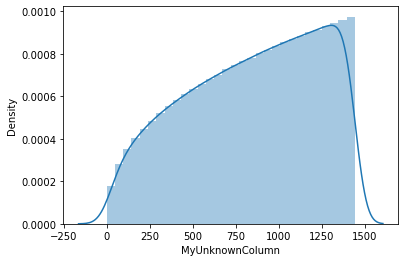

C:\Users\ASUS\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


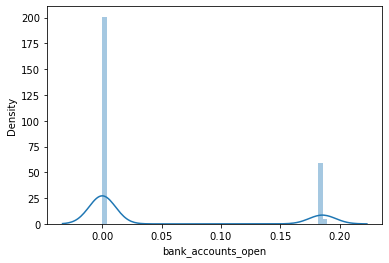

C:\Users\ASUS\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


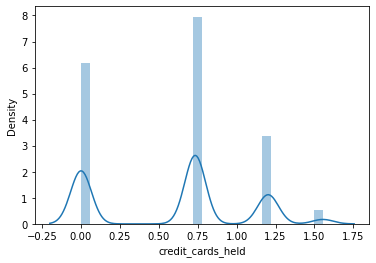

C:\Users\ASUS\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


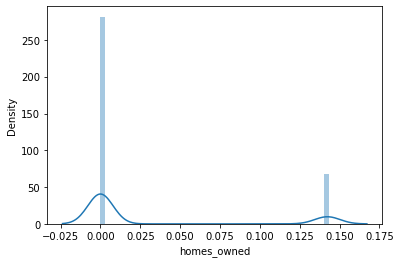

C:\Users\ASUS\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


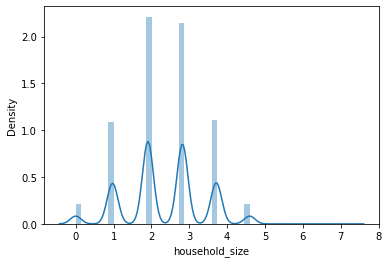

C:\Users\ASUS\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


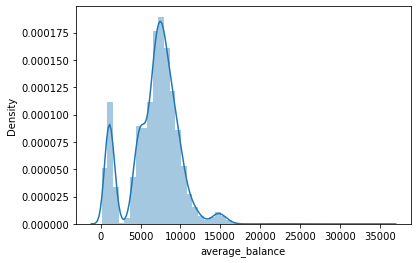

C:\Users\ASUS\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


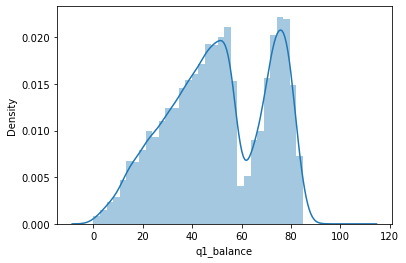

C:\Users\ASUS\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


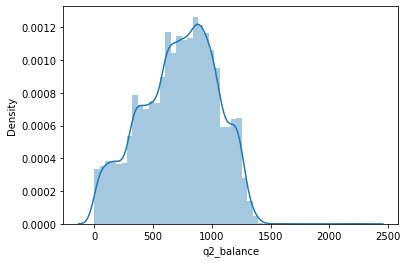

C:\Users\ASUS\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


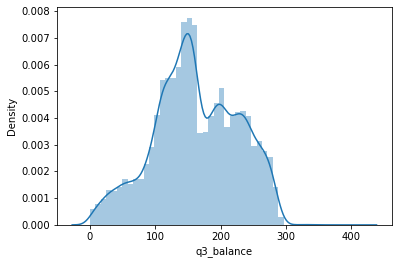

C:\Users\ASUS\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


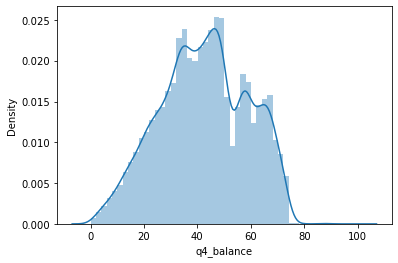

In [27]:
for col in data.select_dtypes(np.number):
    sns.distplot(data[col])
    plt.show()

In [ ]:
# dealing with outliers

In [28]:
def boxcox_transform(data):
    numeric_cols = data.select_dtypes(np.number).columns
    _ci = {column: None for column in numeric_cols}
    for column in numeric_cols:
        
        data[column] = np.where(data[column]<=0, np.NAN, data[column]) 
        data[column] = data[column].fillna(data[column].mean())
        transformed_data, ci = stats.boxcox(data[column])
        data[column] = transformed_data
        _ci[column] = [ci] 
    return data, _ci

In [23]:
data, _ci = boxcox_transform(data)
data

,MyUnknownColumn,offer_accepted,reward,mailer_type,income_level,bank_accounts_open,overdraft_protection,credit_rating,credit_cards_held,homes_owned,household_size,own_your_home,average_balance,q1_balance,q2_balance,q3_balance,q4_balance
customer_number,,,,,,,,,,,,,,,,,
1,883.000390,No,Air Miles,Letter,High,0.000000,No,High,0.733605,0.000000,2.817656,No,8703.958501,73.836626,639.885262,173.975094,50.525011
2,0.000000,No,Air Miles,Letter,Medium,0.000000,No,Medium,0.733605,0.142277,3.711948,Yes,563.218895,10.157140,85.875613,27.328789,30.922576
3,0.894538,No,Air Miles,Postcard,High,0.185023,No,Medium,0.733605,0.000000,0.971778,Yes,1299.266926,34.277501,269.331501,42.538730,25.166504
4,1.661138,No,Air Miles,Letter,Medium,0.185023,No,High,0.000000,0.000000,2.817656,No,9287.622984,71.795308,1237.254765,176.596534,33.055723
5,2.354924,No,Air Miles,Letter,Medium,0.000000,No,Medium,0.733605,0.000000,4.592940,Yes,9206.914353,83.588729,967.349381,161.378408,30.880781
6,2.999148,No,Air Miles,Letter,Medium,0.000000,No,High,1.202554,0.000000,2.817656,No,8249.706326,77.670458,972.746186,133.960036,35.946007
7,3.606445,No,Air Miles,Letter,Medium,0.000000,No,Medium,0.733605,0.000000,1.906390,No,1344.639160,38.837306,148.381053,78.466735,18.491298
8,4.184659,No,Cash Back,Postcard,Low,0.000000,No,Medium,1.554483,0.000000,2.817656,Yes,1311.745184,20.041247,297.572743,68.397244,28.295831
9,4.739090,No,Air Miles,Postcard,Medium,0.000000,No,Low,0.733605,0.000000,2.817656,Yes,7190.728870,53.965016,649.554630,149.843339,58.366911


In [24]:
def remove_outliers(data, threshold=1.5, in_columns=data.select_dtypes(np.number).columns, skip_columns=[]):
    for column in in_columns:
        if column not in skip_columns:
            upper = np.percentile(data[column],75)
            lower = np.percentile(data[column],25)
            iqr = upper - lower
            upper_limit = upper + (threshold * iqr)
            lower_limit = lower - (threshold * iqr)
            data = data[(data[column]>lower_limit) & (data[column]<upper_limit)]
    return data

In [ ]:
from scipy.special import inv_boxcox

predictions = inv_boxcox(predictions, _ci['value'])

# Data pre-processing 

Logistic regression

In [ ]:
Scaling numerical variables and encoding categorical variable

In [ ]:
y = data['value']
X = data.drop(['value'], axis=1)

In [ ]:
numericals = X.select_dtypes(np.number)

In [ ]:
categoricals = X.select_dtypes(exclude=np.number)

In [ ]:
encoder = OneHotEncoder(handle_unknown='error', drop='first').fit(categoricals)
encoded = encoder.transform(categoricals).toarray()

In [ ]:
X = np.concatenate((x_standardized, encoded), axis=1)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=100)

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
model = KNeighborsRegressor(n_neighbors=4)
model.fit(X_train, y_train)

In [ ]:
cat = data.select_dtypes('object')

In [ ]:
X_num = X.select_dtypes(include = np.number)
X_cat = X.select_dtypes(include = object)

In [ ]:
transformer = Normalizer().fit(X_num)
x_normalized = transformer.transform(X_num)
print(x_normalized.shape)

In [ ]:
encoder = OneHotEncoder(handle_unknown='error', drop='first')
encoder.fit(X_cat)

In [ ]:
encoded = encoder.transform(X_cat).toarray()
encoded

In [ ]:
X_cat['position'].value_counts()

# Model 

In [ ]:
X = np.concatenate([x_normalized, encoded], axis=1)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
model = LinearRegression()
model.fit(X_train,y_train)

In [ ]:
predictions  = model.predict(X_test)
predictions.shape

In [ ]:
# Model improvement data imbalance

In [ ]:
# Class Weigh

In [ ]:
# SMOTE
## logistic regression
## KNN algorithm


In [ ]:
# outliers boxplot to identify outliers and remove the unnecessary data

In [ ]:
num = data.select_dtypes('number')
for c in num.columns:
    fig, axes = plt.subplots(1, 2, figsize=(15, 5))
    sns.set_style("darkgrid")
    sns.distplot(num[c], ax=axes[0],  color = 'gray')
    sns.boxplot(num[c], ax=axes[1],  color = 'gray')
    plt.show()


In [ ]:
print(data.shape)

In [ ]:
print(data['offer_accepted'].unique())

In [ ]:
print(data.groupby('offer_accepted').size())

# Choosing the best value of k for the KNN

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
scores = []
for i in range(2,10):
    model = KNeighborsRegressor(n_neighbors=i)
    model.fit(X_train, y_train)
    scores.append(model.score(X_test, y_test))

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(range(2,10),scores,color = 'blue', linestyle='dashed',
         marker='o', markerfacecolor='red', markersize=10)
plt.title('accuracy scores vs. K Value')
plt.xlabel('K')
plt.ylabel('Accuracy')

In [ ]:
# Measures of accuracies for regression models
from sklearn.metrics import mean_absolute_error
score = mean_absolute_error(y_test, predictions)
score

In [ ]:
from sklearn.metrics import mean_squared_error
score = mean_squared_error(y_test, predictions)
score

In [ ]:
import math
from sklearn.metrics import mean_squared_error
mse = mean_squared_error(y_test, predictions)
rmse = math.sqrt(mse)
rmse

In [ ]:
R-squared value

In [ ]:
from sklearn.metrics import r2_score
score = r2_score(y_test, predictions)
score

In [ ]:
score = 1 - (1-score)*(len(y_test)-1)/(len(y_test)-X_test.shape[1]-1)

# -Model Validation

In [ ]:
r2_score(y_test, predictions), mean_squared_error(y_test, predictions, squared=False), mean_squared_error(y_test, predictions)

In [ ]:
r2_score(y_test, predictions), mean_squared_error(y_test, predictions, squared=False), mean_squared_error(y_test, predictions)

In [ ]:
mse = mean_squared_error(y_test, predictions)
print(mse)

In [ ]:
rmse = math.sqrt(mse)
print(rmse)

In [ ]:
r2 = r2_score(y_test, predictions)
print(r2)

In [ ]:
n = len(X_test)
p = X_test.shape[1]
adj_r2 = 1-((1-r2)*(n-1)/(n-p-1))
print(adj_r2)